## Visualize WoFCast Predictions

In [1]:
import ipywidgets as widgets
from IPython.display import display

In [2]:
import os
os.environ['XLA_PYTHON_CLIENT_PREALLOCATE'] = 'true'
os.environ['XLA_PYTHON_CLIENT_MEM_FRACTION'] = '0.95'

import sys, os 
package_path = os.path.dirname(os.path.dirname(os.getcwd())) 
print(f'{package_path=}')
sys.path.insert(0, package_path)

from wofscast.model import WoFSCastModel
from wofscast.border_mask import BORDER_MASK_NUMPY

from wofscast.data_generator import load_chunk, dataset_to_input, add_local_solar_time

# For the diffusion model. 
from wofscast.normalization import PyTorchScaler
from wofscast.diffusion import apply_diffusion, EDMPrecond
from diffusers import UNet2DModel

# Utils for loading data, plotting, animations. 
from wofscast.common.mrms_data_loader import MRMSDataLoader 
from wofscast.common.helpers import (get_case_date, 
                                     to_datetimes, 
                                     get_qpe_datetimes, 
                                     border_difference_check
                                    ) 

from wofscast.common.plot_utils import WoFSCastAnimator 


# To display the animation in a Jupyter notebook
from IPython.display import HTML

# For plotting. 
import numpy as np
import xarray as xr
from datetime import datetime, timedelta

package_path='/home/monte.flora/python_packages/frdd-wofs-cast'


## Load a Dataset

ToDo: Generalize for different base paths!


In [3]:
# Base path for the datasets
base_path = '/work/mflora/wofs-cast-data/datasets_2hr_zarr/2021'

# List of case names
case_options = {
    'Case 1 (Small storms)': 'wrfwof_2021-05-12_200000_to_2021-05-12_221000__10min__ens_mem_14.zarr',
    'Case 2 (Shown to everyone)': 'wrfwof_2021-05-15_020000_to_2021-05-15_041000__10min__ens_mem_09.zarr',
    'Case 3 (Early time of shown case)': 'wrfwof_2021-05-15_000000_to_2021-05-15_021000__10min__ens_mem_09.zarr',
    'Case 4 (Messy Convection over TX)': 'wrfwof_2021-05-07_210000_to_2021-05-07_231000__10min__ens_mem_09.zarr',
    'Case 5 (Good case)': 'wrfwof_2021-05-18_000000_to_2021-05-18_021000__10min__ens_mem_01.zarr',
    'Case 6 (Another case)': 'wrfwof_2021-05-27_000000_to_2021-05-27_021000__10min__ens_mem_01.zarr'
}

# Create a dropdown widget for selecting the case
case_dropdown = widgets.Dropdown(
    options=case_options,
    value='wrfwof_2021-05-15_020000_to_2021-05-15_041000__10min__ens_mem_09.zarr',  # Default value
    description='Select Case:',
    disabled=False,
)

# Create a text widget to display the case date
case_date_text = widgets.Text(
    value='',
    description='Case Date:',
    disabled=True  # Disable editing
)

# Global variable to store the dataset and case date.
dataset, case_date, path = None, None, None

# Function to load the selected case and update the global dataset and case date
def load_selected_case(case_name):
    global dataset, case_date, path  # Reference the global dataset variable
    path = os.path.join(base_path, case_name)
    dataset = load_chunk([path], 1, add_local_solar_time)
    dataset = dataset.compute()
    case_date = get_case_date(path)
    print(f"Loaded dataset for: {case_name} | Case Date: {case_date}")
    return case_date

# Function to handle the change in dropdown selection
def on_case_change(change):
    case_date = load_selected_case(change['new'])
    case_date_text.value = case_date  # Update the text widget with the new case date

# Display the dropdown widget and the case date
display(case_dropdown)
display(case_date_text)

# Attach the handler to the dropdown to load data on selection change
case_dropdown.observe(on_case_change, names='value')

# Initial case loading based on the default selection
case_date = load_selected_case(case_dropdown.value)
case_date_text.value = case_date  # Set the initial case date

Dropdown(description='Select Case:', index=1, options={'Case 1 (Small storms)': 'wrfwof_2021-05-12_200000_to_2…

Text(value='', description='Case Date:', disabled=True)

Loaded dataset for: wrfwof_2021-05-15_020000_to_2021-05-15_041000__10min__ens_mem_09.zarr | Case Date: 20210514


In [4]:
# Load the normalization statistics and initialize the 
# scaler used for the diffusion model. 
norm_stats_path = '/work/mflora/wofs-cast-data/full_normalization_stats'
mean_by_level = xr.load_dataset(os.path.join(norm_stats_path, 'mean_by_level.nc'))
stddev_by_level = xr.load_dataset(os.path.join(norm_stats_path, 'stddev_by_level.nc'))
diffs_stddev_by_level = xr.load_dataset(os.path.join(norm_stats_path, 'diffs_stddev_by_level.nc'))

scaler = PyTorchScaler(mean_by_level, stddev_by_level, diffs_stddev_by_level)

## Load the WoFSCast Model

In [5]:
# List of model paths
model_paths = {
    'Corey\'s biggest model v178': '/work/cpotvin/WOFSCAST/model/wofscast_test_v178.npz',
    'Corey\'s biggest model v207': '/work/cpotvin/WOFSCAST/model/wofscast_test_v207.npz',
    'Model v203': '/work/cpotvin/WOFSCAST/model/wofscast_test_v203.npz',
    '10min model with noise v1': '/work/mflora/wofs-cast-data/model/wofscast_10min_model_noise_v1.npz'
}

# Global variable to store the current model
wofscast = None

# Create a dropdown widget for selecting the model
dropdown = widgets.Dropdown(
    options=model_paths,
    value='/work/cpotvin/WOFSCAST/model/wofscast_test_v178.npz',  # Default value
    description='Select Model:',
    disabled=False,
)

# Function to load the selected model
def load_selected_model(model_path):
    global wofscast  # Ensure we're modifying the global wofscast variable
    wofscast = WoFSCastModel()
    wofscast.load_model(model_path)
    print(f'Model loaded from: {model_path}')

# Display the dropdown widget
display(dropdown)

# Load the selected model when the dropdown value changes
dropdown.observe(lambda change: load_selected_model(change['new']), names='value')

# Initial model loading based on the default selection
load_selected_model(dropdown.value)

Dropdown(description='Select Model:', options={"Corey's biggest model v178": '/work/cpotvin/WOFSCAST/model/wof…

Model loaded from: /work/cpotvin/WOFSCAST/model/wofscast_test_v178.npz


## Load the Diffusion Model

In [6]:
# Create a dropdown widget for refl_only
refl_dropdown = widgets.Dropdown(
    options=[('dBZ Only', True), ('All Variables', False)],
    value=False,  # Default value
    description='Select Mode:',
    disabled=False,
)

model_wrapped, variables = None, None

# Function to update the variables and diffusion model path based on the dropdown selection
def update_model(refl_only):
    global model_wrapped, variables
    domain_size = 160

    if refl_only:
        n_channels=1
        variables = ['COMPOSITE_REFL_10CM']
        diffusion_model_path = "/work/mflora/wofs-cast-data/diffusion_models/diffusion_refl_only_v7"
    else:
        n_channels=105
        variables = None
        diffusion_model_path = "/work/mflora/wofs-cast-data/diffusion_models/diffusion_all_vars_update_v1"

    diffusion_model = UNet2DModel.from_pretrained(diffusion_model_path).to('cuda')
    
    # Assuming 1 channel for 'COMPOSITE_REFL_10CM', adjust as needed
    n_channels = 1  
    model_wrapped = EDMPrecond(domain_size, n_channels, diffusion_model, 
                               sigma_data=0.5, 
                               sigma_max=float('inf'), 
                               sigma_min=0.)

    total_params = sum(p.numel() for p in model_wrapped.parameters())
    print(f"Number of parameters: {total_params/1_000_000:.2f} Million")

# Display the dropdown widget
display(refl_dropdown)

# Update the model based on the dropdown selection
refl_dropdown.observe(lambda change: update_model(change['new']), names='value')

# Initial model setup based on the default selection
update_model(refl_dropdown.value)

Dropdown(description='Select Mode:', index=1, options=(('dBZ Only', True), ('All Variables', False)), value=Fa…

/work/mflora/miniconda3/envs/wofs-cast-gen/lib/python3.10/site-packages/diffusers/models/lora.py:387: FutureWarning: `LoRACompatibleLinear` is deprecated and will be removed in version 1.0.0. Use of `LoRACompatibleLinear` is deprecated. Please switch to PEFT backend by installing PEFT: `pip install peft`.
  deprecate("LoRACompatibleLinear", "1.0.0", deprecation_message)
/work/mflora/miniconda3/envs/wofs-cast-gen/lib/python3.10/site-packages/diffusers/models/lora.py:300: FutureWarning: `LoRACompatibleConv` is deprecated and will be removed in version 1.0.0. Use of `LoRACompatibleConv` is deprecated. Please switch to PEFT backend by installing PEFT: `pip install peft`.
  deprecate("LoRACompatibleConv", "1.0.0", deprecation_message)


Number of parameters: 114.03 Million


## Raw WoFSCast Predictions

In [7]:
# Constants
minutes_per_step = int(os.path.basename(path).split('__')[1].replace('min', ''))
steps_per_hour = 60 // minutes_per_step

dts, n_steps = None, None

# Function to convert hours to time steps and datetimes
def update_datetimes(hours):
    global dts, n_steps
    n_steps = steps_per_hour * hours
    dts = to_datetimes(path, n_times=n_steps + 2)
    print(f"Number of steps: {n_steps}")
    print(f"Datetimes: {dts[0]}-{dts[-1]}")
    return n_steps, dts

# Create a slider widget for selecting the number of hours
hours_slider = widgets.IntSlider(
    value=6,  # Default value
    min=1,  # Minimum value
    max=12,  # Maximum value (24 hours)
    step=1,  # Step size
    description='Hours:',
    continuous_update=False,  # Only update when the slider is released
)

# Display the slider widget
display(hours_slider)

# Function to handle slider value change
def on_hours_change(change):
    n_steps, dts = update_datetimes(change['new'])

# Attach the handler to the slider to update datetimes on value change
hours_slider.observe(on_hours_change, names='value')

# Initial update based on the default slider value
n_steps, dts = update_datetimes(hours_slider.value)

IntSlider(value=6, continuous_update=False, description='Hours:', max=12, min=1)

Number of steps: 36
Datetimes: 2021-05-15 02:20:00-2021-05-15 08:10:00


## Run WoFSCast

In [8]:
%%time 
inputs, targets, forcings = dataset_to_input(dataset, wofscast.task_config, 
                                             target_lead_times=slice('10min', '120min'), 
                                             batch_over_time=False, n_target_steps=12)

predictions = wofscast.predict(inputs,  targets, forcings, initial_datetime=dts[0], n_steps=n_steps)

If using n_steps, then replace_bdry must be False. Setting it to False.
CPU times: user 40 s, sys: 23.7 s, total: 1min 3s
Wall time: 8.35 s


## Post-processing WoFS with Diffusion

In [9]:
%%time
# Notes:
# 1. Lowering the S_churn improved the RMSE; I think thats lower noise though 
# 2. Increaseing S_max improved prediction of the higher refl. values (subjectively)
# 3. Lowering S_noise didn't seem to do much, but that was while S_churn = 0.0, otherwise
#    it does seem to help if S_churn > 0.0. However, it makes the image more noisy 
# 4. Setting sigma_data=0.5, really weakened storms!! Despite the model being trained on sigma_data=1.0
 
sampler_kwargs = dict(
    sigma_min = 0.0002,
    sigma_max = 1000, 
    S_churn=0,#np.sqrt(2)-1, 
    S_min=0.02, 
    S_max=1000, 
    S_noise=1.5) 

# Make a copy of the predictions to update
updated_predictions = predictions.copy(deep=True)

# Loop through each time index and update the predictions
for t in range(predictions.sizes['time']):
    # Select predictions for the current time coordinate
    these_predictions = updated_predictions.isel(time=[t])
    
    # Apply the diffusion process or any other update
    updated_prediction = apply_diffusion(these_predictions, targets, 
                                         model_wrapped, 
                                         scaler, num_steps=20, 
                                         sampler_kwargs=sampler_kwargs, 
                                         variables = variables
                                        )
    
    #diff = updated_prediction['COMPOSITE_REFL_10CM'].isel(time=t) - predictions['COMPOSITE_REFL_10CM'].isel(time=t)
    #print(f'{diff.max().values}, {diff.min().values}')
    
    # Assign the updated prediction back to the correct time index in the updated_predictions dataset
    updated_predictions[dict(time=[t])] = updated_prediction

CPU times: user 1min 3s, sys: 536 ms, total: 1min 3s
Wall time: 26.6 s


## Applying Diffusion In-step with WoFSCast

In [17]:
%%time 
predictions_with_diff = wofscast.predict(inputs, 
                            targets, 
                            forcings, 
                            initial_datetime=dts[0], 
                            n_steps=n_steps,             
                            diffusion_model=model_wrapped, 
                            scaler = scaler,             
                            n_diffusion_steps=50,
                            sampler_kwargs=sampler_kwargs, 
                            variables = variables
                           )

If using n_steps, then replace_bdry must be False. Setting it to False.
CPU times: user 1min 42s, sys: 11.8 s, total: 1min 53s
Wall time: 53.9 s


## Load the MRMS radar and QPE fields 

In [18]:
loader = MRMSDataLoader(case_date, dts)
mrms_dz = loader.load() 
mrms_qpe = loader.load_qpe() 

## Rainfall Verification against MRMS 

## Diffusion post-processing animations

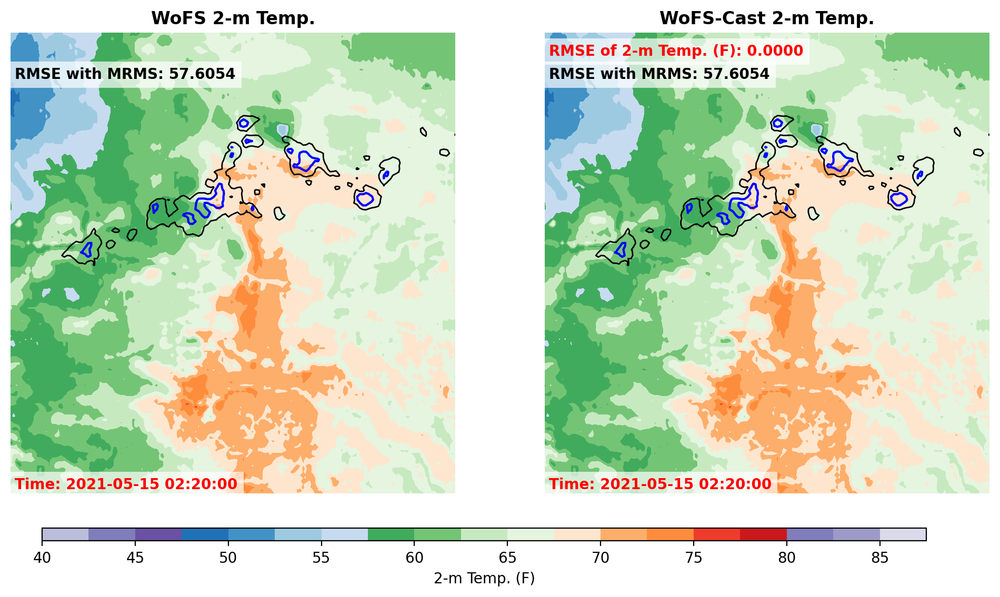

In [22]:
animator = WoFSCastAnimator(domain_size=150, dts=dts)
anim = animator(
                var='T2',
                #var = 'RAIN_AMOUNT',
                #var='COMPOSITE_REFL_10CM', 
                #var = "T",
                #var = 'W',
                #var = 'QVAPOR',
                level='none',
                inputs=inputs, 
                predictions=updated_predictions, 
                targets=targets, 
                mrms_dz = mrms_dz,
                add_rmse=True,
                for_randy=True
               )

# To display the animation in a Jupyter notebook
HTML(anim.to_jshtml())

# Optionally, to save the animation
#anim.save("gifs/wofscast_with_diffusion.gif", writer="pillow", fps=3)   

## Raw WoFSCast

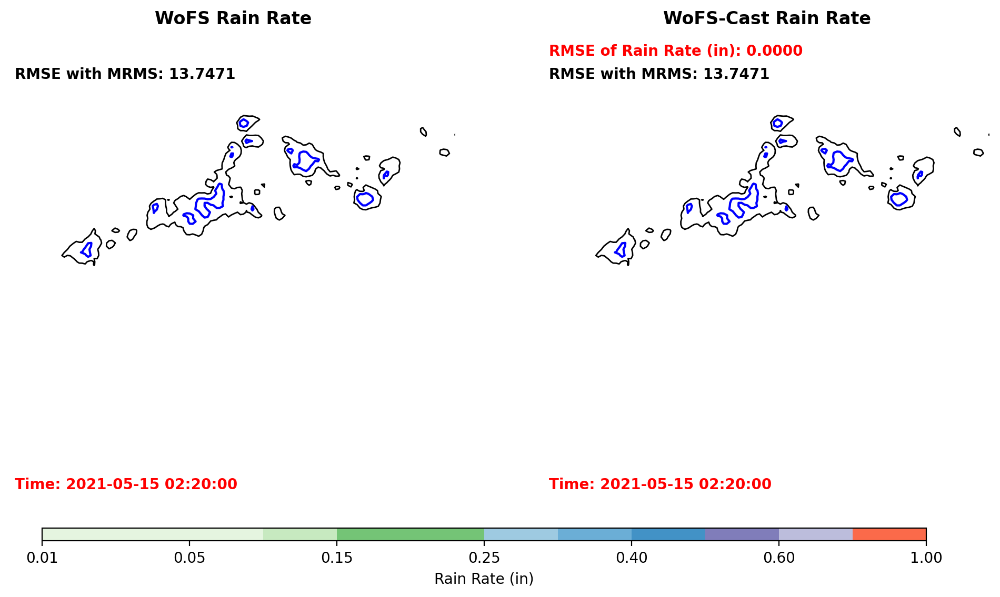

In [13]:
animator = WoFSCastAnimator(domain_size=150, dts=dts)
this_anim = animator(
                var = 'RAIN_AMOUNT',
                #var='T2',
                #var='COMPOSITE_REFL_10CM', 
                #var = "T",
                #var = 'U',
                #var = 'QVAPOR',
                level='none',
                inputs=inputs, 
                predictions=predictions, 
                targets=targets, 
                mrms_dz = mrms_dz, 
                add_rmse=True
               )
HTML(this_anim.to_jshtml())

# Optionally, to save the animation
#anim.save(f"gifs/wofscast_without_diffusion_{hours}hr.gif", writer="pillow", fps=3)   

## Diffusion in-step

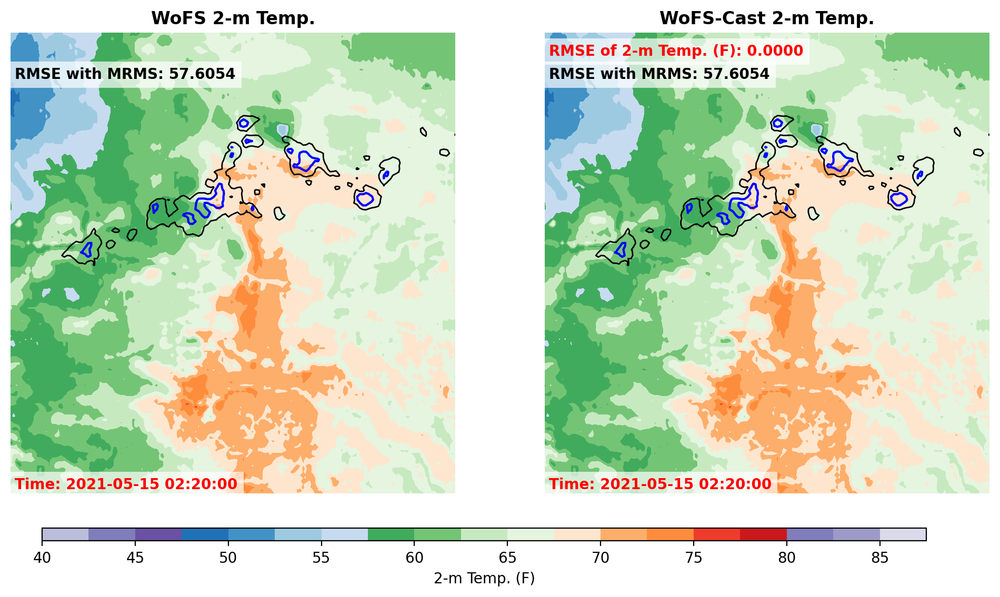

In [21]:
hours = 6

animator = WoFSCastAnimator(domain_size=150, dts=dts)
anim = animator(
                var='T2',
                #var='COMPOSITE_REFL_10CM', 
                #var = "T",
                #var = 'W',
                #var = 'QVAPOR',
                level='none',
                inputs=inputs, 
                predictions=predictions_with_diff, 
                targets=targets, 
                mrms_dz = mrms_dz,
                for_randy=True
               )

HTML(anim.to_jshtml())

# Optionally, to save the animation
#anim.save(f"gifs/wofscast_with_diffusion_instep_{hours}hr.gif", writer="pillow", fps=3) 